## (ACMEGRADE INTERNSHIP)

## Name : Dhanshree Bhimsing Rajput

## Batch: Data Science(Self paced) December'23

## Project1 Name : Detection of Parkinson's Disease


    

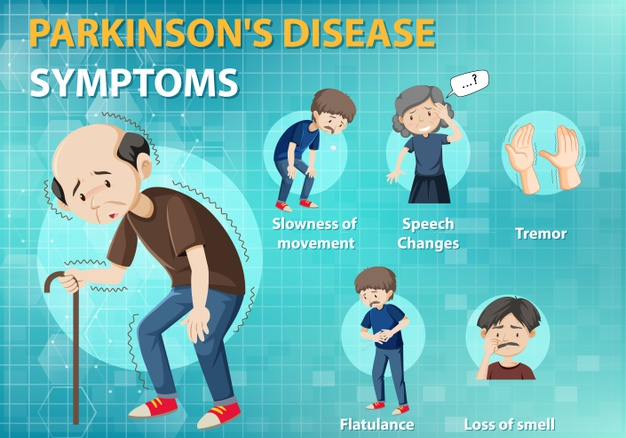

### Summary :


**Building and evaluating a Gradient Boosting Classifier model for predicting Parkinson's disease based on some features provided in the dataset. Here's a summary of what's happening in the code:**

1. **Data Exploration**: Initially, the code visualizes the distribution of numeric features using Seaborn's histplot function. This helps in understanding the skewness and distribution of each numeric feature.

2. **Correlation Analysis**: Next, the code calculates the correlation matrix among the features and visualizes it as a heatmap using Seaborn's heatmap function. This helps in identifying correlations between different features, which can provide insights into potential relationships within the data.

3. **Data Preprocessing**: The 'name' column is dropped from the dataset, assuming it's not contributing to the predictive task. Then, the dataset is split into features (X) and the target variable (Y).

4. **Model Training and Evaluation**: The dataset is split into training and testing sets using the train_test_split function from scikit-learn. A Gradient Boosting Classifier model is trained on the training data and evaluated on both the training and testing sets.

5. **Evaluation Metrics**: Various evaluation metrics such as accuracy, confusion matrix, recall, classification report, and Cohen's Kappa score are calculated and printed to assess the performance of the model on both the training and testing sets.

6. **Pickling**: Finally, there's a mention of creating a pickle file, presumably to save the trained model for future use without having to retrain it every time.


    
    
    
**Parkinson's Disease**: Parkinson's disease is a neurodegenerative disorder that primarily affects movement. It is characterized by symptoms such as tremors, stiffness, slow movements, and impaired balance. Early diagnosis and treatment can help manage symptoms and improve the quality of life for individuals with Parkinson's disease. Machine learning models like the one built in this code can potentially assist in diagnosing Parkinson's disease based on relevant features extracted from patient data.

###### Install the following Libraries 

In [228]:
pip install pandas-profiling

###### Import Libraries

In [229]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report 
import os


###### Check Current Directory 

In [230]:
print (os.getcwd())

D:\Acmegrade (Internship)\Dec 23 DS Day 18 Project-20240214T033544Z-001\Dec 23 DS Day 18 Project\Projects\Detection of Parkinsons Disease


###### Change the directory 

In [231]:
os.chdir('D:\Acmegrade (Internship)\Dec 23 DS Day 18 Project-20240214T033544Z-001\Dec 23 DS Day 18 Project\Projects\Detection of Parkinsons Disease')

print(os.getcwd())

D:\Acmegrade (Internship)\Dec 23 DS Day 18 Project-20240214T033544Z-001\Dec 23 DS Day 18 Project\Projects\Detection of Parkinsons Disease


###### Read Data, display records

In [232]:
df=pd.read_csv('parkinsons.data')
display (df)


,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


###### Attribute Information: Target column - Status

Matrix column entries (attributes):

name - ASCII subject name and recording number

MDVP:Fo(Hz) - Average vocal fundamental frequency

MDVP:Fhi(Hz) - Maximum vocal fundamental frequency

MDVP:Flo(Hz) - Minimum vocal fundamental frequency

MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP - Several measures of variation in fundamental frequency

MDVP:Shimmer,MDVP:Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,MDVP:APQ,Shimmer:DDA - Several measures of variation in amplitude

NHR,HNR - Two measures of ratio of noise to tonal components in the voice

$$status - Health status of the subject (one) -Parkinson's, (zero) - healthy$$

RPDE,D2 - Two nonlinear dynamical complexity measures
DFA - Signal fractal scaling exponent

spread1,spread2,PPE - Three nonlinear measures of fundamental frequency variation



In [233]:
df.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


In [234]:
df.tail()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306
194,phon_R01_S50_6,214.289,260.277,77.973,0.00567,0.00003,0.00295,0.00317,0.00885,0.01884,...,0.03078,0.04398,21.209,0,0.462803,0.664357,-5.724056,0.190667,2.555477,0.148569


###### Pandas Profiling Report 

In [235]:
import pandas_profiling as pf
display(pf.ProfileReport(df))


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###### Display the shape 

In [236]:
display (df.shape)

(195, 24)

###### Number of rows 

In [237]:
print (len(df))

195


###### Display the data type of all columns  

In [238]:
display (df.dtypes )

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object

###### Display Details 

In [239]:
print (df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

###### Describe the details 

In [240]:
display (df.describe())

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
count,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,...,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000
mean,154.228641,197.104918,116.324631,0.006220,0.000044,0.003306,0.003446,0.009920,0.029709,0.282251,...,0.046993,0.024847,21.885974,0.753846,0.498536,0.718099,-5.684397,0.226510,2.381826,0.206552
std,41.390065,91.491548,43.521413,0.004848,0.000035,0.002968,0.002759,0.008903,0.018857,0.194877,...,0.030459,0.040418,4.425764,0.431878,0.103942,0.055336,1.090208,0.083406,0.382799,0.090119
min,88.333000,102.145000,65.476000,0.001680,0.000007,0.000680,0.000920,0.002040,0.009540,0.085000,...,0.013640,0.000650,8.441000,0.000000,0.256570,0.574282,-7.964984,0.006274,1.423287,0.044539
25%,117.572000,134.862500,84.291000,0.003460,0.000020,0.001660,0.001860,0.004985,0.016505,0.148500,...,0.024735,0.005925,19.198000,1.000000,0.421306,0.674758,-6.450096,0.174351,2.099125,0.137451
50%,148.790000,175.829000,104.315000,0.004940,0.000030,0.002500,0.002690,0.007490,0.022970,0.221000,...,0.038360,0.011660,22.085000,1.000000,0.495954,0.722254,-5.720868,0.218885,2.361532,0.194052
75%,182.769000,224.205500,140.018500,0.007365,0.000060,0.003835,0.003955,0.011505,0.037885,0.350000,...,0.060795,0.025640,25.075500,1.000000,0.587562,0.761881,-5.046192,0.279234,2.636456,0.252980
max,260.105000,592.030000,239.170000,0.033160,0.000260,0.021440,0.019580,0.064330,0.119080,1.302000,...,0.169420,0.314820,33.047000,1.000000,0.685151,0.825288,-2.434031,0.450493,3.671155,0.527367


###### Check for Null Values 

In [241]:
display (df.isna().sum() )

name                0
MDVP:Fo(Hz)         0
MDVP:Fhi(Hz)        0
MDVP:Flo(Hz)        0
MDVP:Jitter(%)      0
MDVP:Jitter(Abs)    0
MDVP:RAP            0
MDVP:PPQ            0
Jitter:DDP          0
MDVP:Shimmer        0
MDVP:Shimmer(dB)    0
Shimmer:APQ3        0
Shimmer:APQ5        0
MDVP:APQ            0
Shimmer:DDA         0
NHR                 0
HNR                 0
status              0
RPDE                0
DFA                 0
spread1             0
spread2             0
D2                  0
PPE                 0
dtype: int64

###### Display column details  

In [108]:
print (df.columns)

Index(['name', 'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
       'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
       'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'status', 'RPDE', 'DFA',
       'spread1', 'spread2', 'D2', 'PPE'],
      dtype='object')


###### Display the dependent variable  

In [17]:
# status - health status of the subject (one) - Parkinson's, (zero) – healthy

In [242]:
print (df['status'])

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64


###### Create Histogram with Status column 

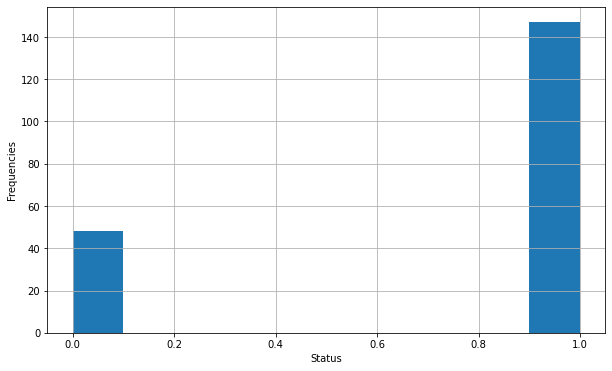

In [243]:
# The dataset has high number of patients effected with Parkinson's disease.

plt.figure(figsize=(10, 6))
df.status.hist()
plt.xlabel('Status')
plt.ylabel('Frequencies')
plt.plot()
plt.show()


###### Create Bar graph- X-Axis Status, Y- Axis NHR


**The patients affected with Parkinson's disease have high NHR which is the measure of the ratio of noise to tonal components in the voice.** 



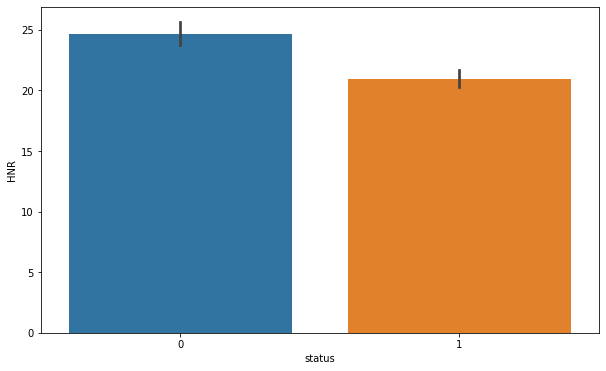

In [244]:
plt.figure(figsize=(10, 6))
sns.barplot(x="status",y="HNR",data=df);
plt.show()


###### Create Bar graph- X-Axis Status, Y- Axis RPDE

**The nonlinear dynamical complexity measure RPDE is high in the patients affected with Parkinson's disease.**

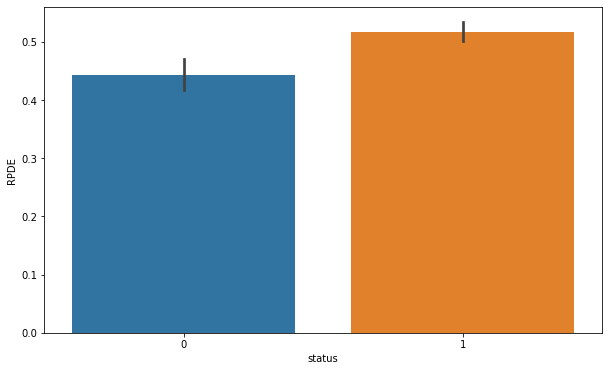

In [245]:
plt.figure(figsize=(10, 6))
sns.barplot(x="status",y="RPDE",data=df);
plt.show()


###### Create Distribution plot – This used to check skewness in data  

**In this modification, I've  use Seaborn's histplot function, displayed the correlation matrix using a heatmap, and adjusted the splitting of the dataset into train and test sets.**

In [246]:
import seaborn as sns
import matplotlib.pyplot as plt




In [247]:
# Selecting numeric columns for distribution plot

numeric_cols = df.select_dtypes(include=['float64']).columns


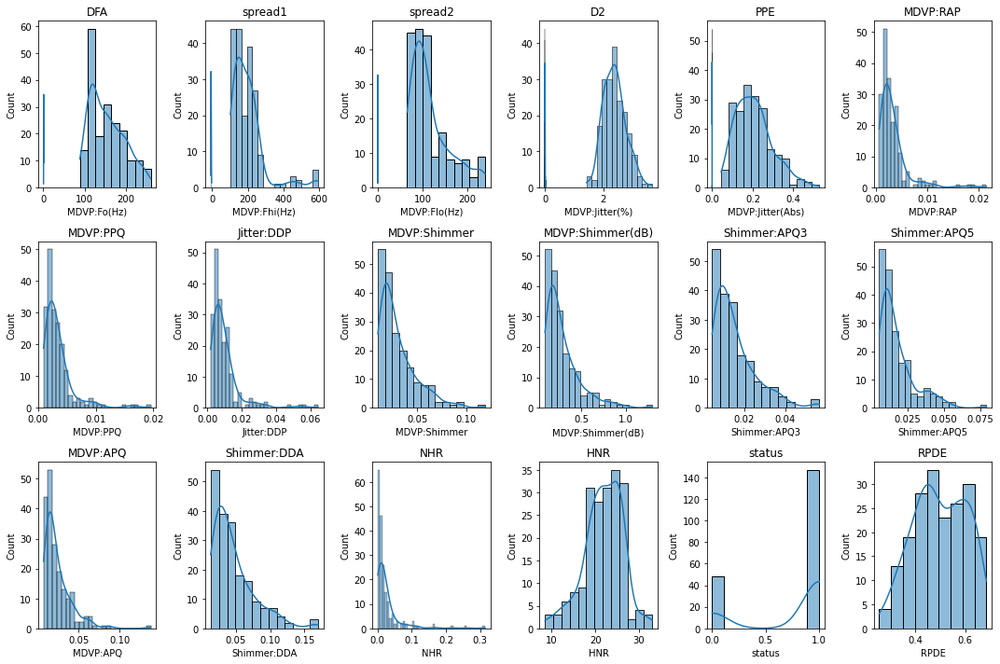

In [248]:
# Plotting distribution plots for numeric columns

import warnings
warnings.filterwarnings('ignore')



plt.figure(figsize=(15, 10))
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
num_plots = len(numeric_cols)
rows = 3
cols = 6

for i, col in enumerate(numeric_cols):
    plt.subplot(rows, cols, i % (rows * cols) + 1)  # Correcting the subplot index
    sns.histplot(df[col], kde=True)
    plt.title(col)

plt.tight_layout()
plt.show()


###### Display Co relation Matrix 

In [249]:

corr = df.corr()
display (corr)


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
MDVP:Fo(Hz),1.000000,0.400985,0.596546,-0.118003,-0.382027,-0.076194,-0.112165,-0.076213,-0.098374,-0.073742,...,-0.094732,-0.021981,0.059144,-0.383535,-0.383894,-0.446013,-0.413738,-0.249450,0.177980,-0.372356
MDVP:Fhi(Hz),0.400985,1.000000,0.084951,0.102086,-0.029198,0.097177,0.091126,0.097150,0.002281,0.043465,...,-0.003733,0.163766,-0.024893,-0.166136,-0.112404,-0.343097,-0.076658,-0.002954,0.176323,-0.069543
MDVP:Flo(Hz),0.596546,0.084951,1.000000,-0.139919,-0.277815,-0.100519,-0.095828,-0.100488,-0.144543,-0.119089,...,-0.150737,-0.108670,0.210851,-0.380200,-0.400143,-0.050406,-0.394857,-0.243829,-0.100629,-0.340071
MDVP:Jitter(%),-0.118003,0.102086,-0.139919,1.000000,0.935714,0.990276,0.974256,0.990276,0.769063,0.804289,...,0.746635,0.906959,-0.728165,0.278220,0.360673,0.098572,0.693577,0.385123,0.433434,0.721543
MDVP:Jitter(Abs),-0.382027,-0.029198,-0.277815,0.935714,1.000000,0.922911,0.897778,0.922913,0.703322,0.716601,...,0.697170,0.834972,-0.656810,0.338653,0.441839,0.175036,0.735779,0.388543,0.310694,0.748162
MDVP:RAP,-0.076194,0.097177,-0.100519,0.990276,0.922911,1.000000,0.957317,1.000000,0.759581,0.790652,...,0.744919,0.919521,-0.721543,0.266668,0.342140,0.064083,0.648328,0.324407,0.426605,0.670999
MDVP:PPQ,-0.112165,0.091126,-0.095828,0.974256,0.897778,0.957317,1.000000,0.957319,0.797826,0.839239,...,0.763592,0.844604,-0.731510,0.288698,0.333274,0.196301,0.716489,0.407605,0.412524,0.769647
Jitter:DDP,-0.076213,0.097150,-0.100488,0.990276,0.922913,1.000000,0.957319,1.000000,0.759555,0.790621,...,0.744901,0.919548,-0.721494,0.266646,0.342079,0.064026,0.648328,0.324377,0.426556,0.671005
MDVP:Shimmer,-0.098374,0.002281,-0.144543,0.769063,0.703322,0.759581,0.797826,0.759555,1.000000,0.987258,...,0.987626,0.722194,-0.835271,0.367430,0.447424,0.159954,0.654734,0.452025,0.507088,0.693771
MDVP:Shimmer(dB),-0.073742,0.043465,-0.119089,0.804289,0.716601,0.790652,0.839239,0.790621,0.987258,1.000000,...,0.963202,0.744477,-0.827805,0.350697,0.410684,0.165157,0.652547,0.454314,0.512233,0.695058


###### Display Heatmap

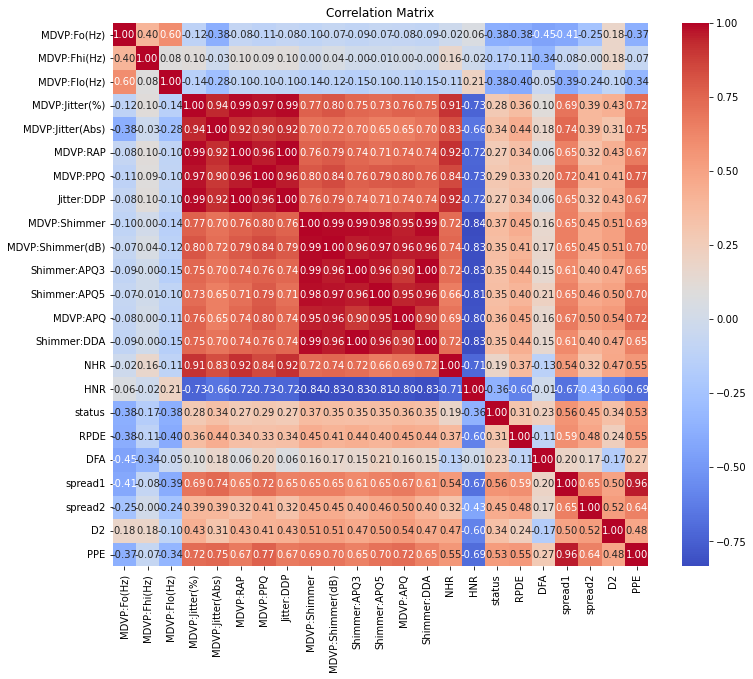

In [250]:
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix")
plt.show()


In [251]:
# Drop the name column

df.drop(['name'], axis=1, inplace=True)
display(df)


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,0.405,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,0.263,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,0.256,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,0.241,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


###### Heatmap with Default Parameters 

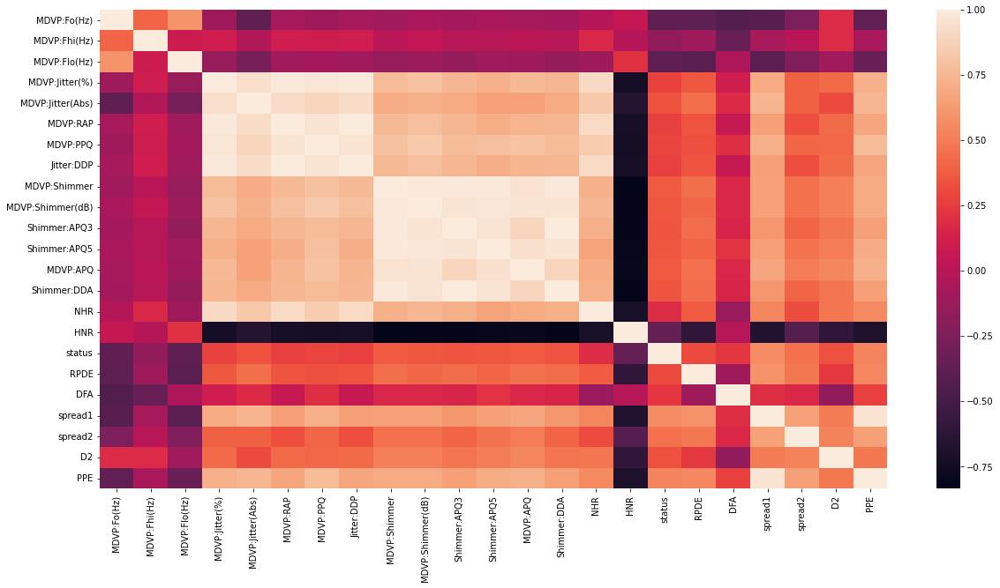

In [252]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10
sns.heatmap(corr)
plt.show()


###### Spitting the dataset into x and y
###### Create X

In [253]:

X=df.drop(labels=['status'],axis=1)
display (X.head())


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.02971,0.06545,0.02211,21.033,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.04368,0.09403,0.01929,19.085,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.03590,0.08270,0.01309,20.651,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.03772,0.08771,0.01353,20.644,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.04465,0.10470,0.01767,19.649,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


###### Create -Y

In [254]:
Y=df['status']
display (Y.head())


0    1
1    1
2    1
3    1
4    1
Name: status, dtype: int64

###### Splitting the data into x_train, y_train, x_test, y_test

In [255]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=40)
print (X.shape,Y.shape)
print(X_train.shape,X_test.shape,Y_train.shape,Y_test.shape)


(195, 22) (195,)
(156, 22) (39, 22) (156,) (39,)


##### Random Forest Regression 

This code trains a Random Forest regressor **using RandomForestRegressor** from **sklearn.ensemble** and evaluates its performance using mean squared error and R2 score instead of accuracy.

In [256]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Train Random Forest regressor
RF = RandomForestRegressor().fit(X_train, Y_train)

# Predict on train set
train_preds2 = RF.predict(X_train)

# Calculate mean squared error on train set
train_mse = mean_squared_error(Y_train, train_preds2)
print("Mean Squared Error on train is: ", train_mse)

# Calculate R2 score on train set
train_r2 = r2_score(Y_train, train_preds2)
print("R2 Score on train is: ", train_r2)

# Predict on test set
test_preds2 = RF.predict(X_test)

# Calculate mean squared error on test set
test_mse = mean_squared_error(Y_test, test_preds2)
print("Mean Squared Error on test is: ", test_mse)

# Calculate R2 score on test set
test_r2 = r2_score(Y_test, test_preds2)
print("R2 Score on test is: ", test_r2)


Mean Squared Error on train is:  0.01267820512820513
R2 Score on train is:  0.933505
Mean Squared Error on test is:  0.06714358974358975
R2 Score on test is:  0.5882040322580644


Since this is regression, there's no confusion matrix or accuracy score. Instead, mean squared error and R2 score are used as evaluation metrics.


#### Create a Gradient Boosting Classifier  Model 

In [257]:
GB = GradientBoostingClassifier().fit(X_train, Y_train)

In [258]:
# predict on train

train_preds = GB.predict(X_train)

In [259]:
# accuracy on train

print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))


Model accuracy on train is:  1.0


In [260]:
#predict on test

test_preds = GB.predict(X_test)


In [162]:
#accuracy on test

print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))
print('-'*50)



Model accuracy on test is:  0.8717948717948718
--------------------------------------------------


In [261]:
print("Confusion matrix train is: \n", confusion_matrix(Y_train, train_preds))
print("Confusion matrix test is:\n ", confusion_matrix(Y_test, test_preds))
print('Wrong predictions out of total')
print('-' * 50)

print("Recall", metrics.recall_score(Y_test, test_preds))
print('-' * 50)
print('\nClassification Report Train is ')
print(classification_report(Y_train, train_preds))
print('\nClassification Report Test is ')
print(classification_report(Y_test, test_preds))


Confusion matrix train is: 
 [[ 40   0]
 [  0 116]]
Confusion matrix test is:
  [[ 6  2]
 [ 3 28]]
Wrong predictions out of total
--------------------------------------------------
Recall 0.9032258064516129
--------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.67      0.75      0.71         8
           1       0.93      0.90      0.92        31

    accuracy                           0.87        39
   macro avg       0.80      0.83      0.81        39
weighted avg       0.88      0.87      0.87        39



###### Wrong Predictions made.

In [262]:
print((Y_test !=test_preds2).sum(),'/',((Y_test == test_preds2).sum()+(Y_test != test_preds2).sum()))

27 / 39


##### Kappa Score

In [263]:

print('KappaScore is: ', metrics.cohen_kappa_score(Y_test, test_preds))


KappaScore is:  0.6242774566473989


##### Display the test and Predicted Values 

In [264]:

ddf=pd.DataFrame(data=[test_preds2,Y_test])
display (ddf)


,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,0.91,0.99,0.91,0.21,0.94,0.73,1.0,1.0,1.0,0.63,...,0.89,0.14,0.01,0.03,0.64,1.0,0.86,1.0,0.58,1.0
1,1.00,1.00,1.00,0.00,1.00,0.00,1.0,1.0,1.0,0.00,...,1.00,0.00,0.00,0.00,1.00,1.0,1.00,1.0,1.00,1.0


###### Transpose and display

In [265]:
display (ddf.T)  

,0,1
0,0.91,1.0
1,0.99,1.0
2,0.91,1.0
3,0.21,0.0
4,0.94,1.0
5,0.73,0.0
6,1.00,1.0
7,1.00,1.0
8,1.00,1.0
9,0.63,0.0


###### Create Pickle File

In [266]:
import pickle

In [267]:
# Saving model to disk

pickle.dump(GB, open('deploy_GB.pkl', 'wb'))


In [268]:
# Open the Pickle File

model = pickle.load(open('deploy_GB.pkl', 'rb'))


In [269]:
# Prediction
print(model.predict(X_train))


[1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1
 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 0 0 1 1]


###### AdaBoost Classifier

In [270]:
from sklearn.ensemble import AdaBoostClassifier

In [271]:
#fit the model on train data
AD = AdaBoostClassifier().fit(X,Y)


In [272]:
#predict on train 
train_preds3 = AD.predict(X_train)

In [273]:
#accuracy on train

print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds3))


Model accuracy on train is:  1.0


In [274]:
#predict on test
test_preds3 = AD.predict(X_test)


In [275]:
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds3))
print('-'*50)


Model accuracy on test is:  1.0
--------------------------------------------------


In [276]:
#Confusion matrix

print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds3))
print("confusion_matrix test is: \n", confusion_matrix(Y_test, test_preds3))
print('Wrong predictions out of total')
print('-'*50)
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds3))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds3))


confusion_matrix train is:
  [[ 40   0]
 [  0 116]]
confusion_matrix test is: 
 [[ 8  0]
 [ 0 31]]
Wrong predictions out of total
--------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         8
           1       1.00      1.00      1.00        31

    accuracy                           1.00        39
   macro avg       1.00      1.00      1.00        39
weighted avg       1.00      1.00      1.00        39



###### Wrong Prediction and Kappa Score 

In [277]:
# Wrong Predictions made.
print((Y_test !=test_preds3).sum(),'/',((Y_test == test_preds3).sum()+(Y_test != test_preds3).sum()))
print('-'*50)

0 / 39
--------------------------------------------------


##### Kappa Score

In [278]:


print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds3))


KappaScore is:  1.0


###### Gaussian Naive Bayes:

In [279]:
from sklearn.naive_bayes import GaussianNB

#fit the model on train data 
GNB=GaussianNB()
GNB.fit(X_train,Y_train)

#predict on train 
train_preds4 = GNB.predict(X_train)

#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds4))


Model accuracy on train is:  0.7307692307692307


In [280]:
#predict on test
test_preds4 = GNB.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds4))
print('-'*50)


Model accuracy on test is:  0.6923076923076923
--------------------------------------------------


In [281]:
#Confusion matrix
print("confusion_matrix train is: \n", confusion_matrix(Y_train, train_preds4))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds4))
print('Wrong predictions out of total')
print('-'*50)
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds4))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds4))


confusion_matrix train is: 
 [[38  2]
 [40 76]]
confusion_matrix test is:
  [[ 8  0]
 [12 19]]
Wrong predictions out of total
--------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.49      0.95      0.64        40
           1       0.97      0.66      0.78       116

    accuracy                           0.73       156
   macro avg       0.73      0.80      0.71       156
weighted avg       0.85      0.73      0.75       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.40      1.00      0.57         8
           1       1.00      0.61      0.76        31

    accuracy                           0.69        39
   macro avg       0.70      0.81      0.67        39
weighted avg       0.88      0.69      0.72        39



###### Wrong Prediction and Kappa Score   

In [282]:
# Wrong Predictions made.

print((Y_test !=test_preds4).sum(),'/',((Y_test == test_preds4).sum()+(Y_test != test_preds4).sum()))
print('-'*50)


12 / 39
--------------------------------------------------


In [283]:
# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds4))


KappaScore is:  0.3937823834196892


###### Multi-layer Perceptron (MLP) classifier

In [284]:
from sklearn.neural_network import MLPClassifier

In [285]:
#fit the model on train data 
MLP = MLPClassifier().fit(X_train,Y_train)

#predict on train 
train_preds5 = MLP.predict(X_train)

#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds5))


Model accuracy on train is:  0.8205128205128205


In [286]:
#predict on test

test_preds5 = MLP.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds5))
print('-'*50)


Model accuracy on test is:  0.8717948717948718
--------------------------------------------------


In [287]:
#Confusion matrix

print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds5))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds5))
print('Wrong predictions out of total')
print('-'*50)
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds5))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds5))


confusion_matrix train is:
  [[ 14  26]
 [  2 114]]
confusion_matrix test is:
  [[ 4  4]
 [ 1 30]]
Wrong predictions out of total
--------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.88      0.35      0.50        40
           1       0.81      0.98      0.89       116

    accuracy                           0.82       156
   macro avg       0.84      0.67      0.70       156
weighted avg       0.83      0.82      0.79       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.80      0.50      0.62         8
           1       0.88      0.97      0.92        31

    accuracy                           0.87        39
   macro avg       0.84      0.73      0.77        39
weighted avg       0.87      0.87      0.86        39




###### Wrong Prediction and Kappa Score   


In [288]:
# Wrong Predictions made.
print((Y_test !=test_preds5).sum(),'/',((Y_test == test_preds5).sum()+(Y_test != test_preds5).sum()))

print('-'*50)


5 / 39
--------------------------------------------------


In [289]:
# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds5))


KappaScore is:  0.5433255269320842



###### Support Vector Machine 


In [290]:
from sklearn.svm import SVC
#fit the model on train data 
SVM = SVC(kernel='linear')
SVM.fit(X_train, Y_train)


SVC(kernel='linear')

In [291]:
#predict on train 
train_preds6 = SVM.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds6))


Model accuracy on train is:  0.8782051282051282


In [84]:
#predict on test
test_preds6 = SVM.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds6))
print('-'*50)


Model accuracy on test is:  0.8974358974358975
--------------------------------------------------


In [292]:
#Confusion matrix

print("confusion_matrix train is: \n", confusion_matrix(Y_train, train_preds6))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds6))
print('Wrong predictions out of total')
print('-'*50)

print("recall", metrics.recall_score(Y_test, test_preds6))
print('-'*50)
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds6))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds6))   


confusion_matrix train is: 
 [[ 23  17]
 [  2 114]]
confusion_matrix test is:
  [[ 5  3]
 [ 1 30]]
Wrong predictions out of total
--------------------------------------------------
recall 0.967741935483871
--------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       0.92      0.57      0.71        40
           1       0.87      0.98      0.92       116

    accuracy                           0.88       156
   macro avg       0.90      0.78      0.82       156
weighted avg       0.88      0.88      0.87       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.83      0.62      0.71         8
           1       0.91      0.97      0.94        31

    accuracy                           0.90        39
   macro avg       0.87      0.80      0.83        39
weighted avg       0.89      0.90      0.89        39



##### Wrong Prediction and Kappa Score   

In [293]:
# Wrong Predictions made.

print((Y_test !=test_preds6).sum(),'/',((Y_test == test_preds6).sum()+(Y_test != test_preds6).sum()))
print('-'*50)


4 / 39
--------------------------------------------------


In [294]:
# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds6))


KappaScore is:  0.6533333333333333


###### Create Pickle File    

In [295]:
import pickle 
# Saving model to disk
pickle.dump(SVM,open('deploy_SVM.pkl','wb'))
# Open the Pickle File 
model=pickle.load(open('deploy_SVM.pkl','rb'))
# Prediction 
print (model.predict (X_train))


[1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 0 1 1]
